# CNN Trainig Templete
## Based on Tensorlfow - CNN MNIST example
https://github.com/tensorflow/tensorflow/blob/r1.6/tensorflow/examples/tutorials/layers/cnn_mnist.py

## 필요한 library 호출

In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import numpy as np
import tensorflow as tf

import cv2

import os

tf.logging.set_verbosity(tf.logging.INFO)


/usr/local/lib/python3.5/dist-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


## CNN model 설계
현재는 MNIST에 사용된 것으로, 추후 그물 찢김에 적용하기 위해 수정 필요

### Input Layer
Input Image Pixel: 28x28  
Color channel: 1 (grayscale)  

### 1st Conv Layer
Num of filter: 32  
Kernel size: 5x5  
Padding: Same  
Activation: ReLU  
Padding same은 입/출력이 같은 크기를 갖도록 padding하는 것  

### 1st Pooling Layer
Max pooling  
Size: 2x2  
Stride: 2  
Max pooling 시 size의 폭과 stride가 같으면 pooling window가 서로 겹치지 않음  

### 2nd Conv Layer
Num of filter: 64  
Kernel size: 5x5  
Padding: Same  
Activation: ReLU  

### 2nd Pooling Layer
Max pooling  
Size: 2x2  
Stride: 2  


### 3rd, 4th, 5th


### Dense Layer
Fully connected  

### Drop out
Rate: 0.4 (40%)  
훈련 중 40%의 connection이 임의로 제거됨  
Overfitting 방지  
뇌의학에서도 학습을 반복할수록 사람 뇌의 뉴런은 일부 connection이 끊어지면서 더 확실하게 학습한다고 함  

### Logits Layer
Binaray classification  

### Training
Loss function: Softmax Cross Entropy  
Optimizer: Gradient Descent  
Learning rate: 0.001  

In [2]:
def cnn_model_fn(features, labels, mode):
    
    """Model function for CNN."""
    # Input Layer
    # Reshape X to 4-D tensor: [batch_size, height, width, channels]
    # Our Fishing net image size is 640x480 and 3-channel (RGB)
    # For grayscale
    num_channel = 1
    input_layer = tf.reshape(features["x"], [-1, 480, 640, num_channel])

    # Convolutional Layer #1
    # Computes 48 features using a 5x5 filter with ReLU activation.
    # Padding is added to preserve width and height.
    # Input Tensor Shape: [batch_size, 480, 640, 3]
    # Output Tensor Shape: [batch_size, 480, 640, 48]
    conv1 = tf.layers.conv2d(
        
        inputs=input_layer,
        filters=48,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    #print(conv1.shape)

    # Pooling Layer #1
    # First max pooling layer with a 2x2 filter and stride of 2
    # Input Tensor Shape: [batch_size, 480, 640, 48]
    # Output Tensor Shape: [batch_size, 240, 320, 48]
    pool1 = tf.layers.max_pooling2d(inputs=conv1, pool_size=[2, 2], strides=2)
    #print(pool1.shape)

    # Convolutional Layer #2
    # Computes 96 features using a 5x5 filter.
    # Padding is added to preserve width and height.
    # Input Tensor Shape: [batch_size, 240, 320, 48]
    # Output Tensor Shape: [batch_size, 240, 320, 96]
    conv2 = tf.layers.conv2d(
        inputs=pool1,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    #print(conv2.shape)

    # Pooling Layer #2
    # Second max pooling layer with a 2x2 filter and stride of 2
    # Input Tensor Shape: [batch_size, 240, 320, 96]
    # Output Tensor Shape: [batch_size, 120, 160, 96]
    pool2 = tf.layers.max_pooling2d(inputs=conv2, pool_size=[2, 2], strides=2)
    #print(pool2.shape)

    
    
    
    # Input Tensor Shape: [batch_size, 120, 160, 96]
    # Output Tensor Shape: [batch_size, 120, 160, 96]    
    conv3 = tf.layers.conv2d(
        inputs=pool2,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    #print(conv3.shape)
    
    # Input Tensor Shape: [batch_size, 120, 160, 96]
    # Output Tensor Shape: [batch_size, 60, 80, 96]
    pool3 = tf.layers.max_pooling2d(inputs=conv3, pool_size=[2, 2], strides=2)
    print(pool3.shape)
    
    
    
    # Input Tensor Shape: [batch_size, 60, 80, 96]
    # Output Tensor Shape: [batch_size, 60, 80, 96]    
    conv4 = tf.layers.conv2d(
        inputs=pool3,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    #print(conv4.shape)
    
    # Input Tensor Shape: [batch_size, 60, 80, 96]
    # Output Tensor Shape: [batch_size, 30, 40, 96]
    pool4 = tf.layers.max_pooling2d(inputs=conv4, pool_size=[2, 2], strides=2)
    #print(pool4.shape)
    
    
    
    # Input Tensor Shape: [batch_size, 30, 40, 96]
    # Output Tensor Shape: [batch_size, 30, 40, 96]    
    conv5 = tf.layers.conv2d(
        inputs=pool4,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    #print(conv5.shape)
    
    # Input Tensor Shape: [batch_size, 30, 40, 96]
    # Output Tensor Shape: [batch_size, 15, 20, 96]
    pool5 = tf.layers.max_pooling2d(inputs=conv5, pool_size=[2, 2], strides=2)
    #print(pool5.shape)
    
    
    
    
    # Flatten tensor into a batch of vectors
    # Input Tensor Shape: [batch_size, 15, 20, 96]
    # Output Tensor Shape: [batch_size, 15 * 20 * 96]
    pool5_flat = tf.reshape(pool5, [-1, 15 * 20 * 96])
    print(pool5_flat.shape)


    # Dense Layer
    # Densely connected layer with 1024 neurons
    # Input Tensor Shape: [batch_size, 15 * 20 * 96]
    # Output Tensor Shape: [batch_size, 1024]
    dense = tf.layers.dense(inputs=pool5_flat, units=1024, activation=tf.nn.relu)
    #print(dense.shape)

    # Add dropout operation; 0.6 probability that element will be kept
    dropout = tf.layers.dropout(
        inputs=dense, rate=0.4, training=mode == tf.estimator.ModeKeys.TRAIN)

    # Logits layer
    # Input Tensor Shape: [batch_size, 1024]
    # Output Tensor Shape: [batch_size, 1]
    logits = tf.layers.dense(inputs=dropout, units=2)
    #print(logits.shape)

    predictions = {
        # Generate predictions (for PREDICT and EVAL mode)
        "classes": tf.argmax(input=logits, axis=1),
        # Add `softmax_tensor` to the graph. It is used for PREDICT and by the
        # `logging_hook`.
        "probabilities": tf.nn.softmax(logits, name="softmax_tensor")
    }
    if mode == tf.estimator.ModeKeys.PREDICT:
        return tf.estimator.EstimatorSpec(mode=mode, predictions=predictions)

    # Calculate Loss (for both TRAIN and EVAL modes)
    loss = tf.losses.sparse_softmax_cross_entropy(labels=labels, logits=logits)
    # sparse_softmax_cross_entropy cannot use one-hot encoding
    
    #loss = tf.nn.sigmoid_cross_entropy_with_logits(labels=labels, logits=logits)

    # Configure the Training Op (for TRAIN mode)
    if mode == tf.estimator.ModeKeys.TRAIN:
        optimizer = tf.train.GradientDescentOptimizer(learning_rate=0.001)
        train_op = optimizer.minimize(
            loss=loss,
            global_step=tf.train.get_global_step())
        return tf.estimator.EstimatorSpec(mode=mode, loss=loss, train_op=train_op)

    # Add evaluation metrics (for EVAL mode)
    eval_metric_ops = {
        "accuracy": tf.metrics.accuracy(
            labels=labels, predictions=predictions["classes"])}
    return tf.estimator.EstimatorSpec(
        mode=mode, loss=loss, eval_metric_ops=eval_metric_ops)

## Code Run


### Training
Batch size: 128  
Epoch: 5  
Shuffle: True  
Step: 20000

## Loading dataset
Load dataset and split them into training data and evaluation data

In [3]:
# torn: 0-1484
# untorn: 0-1779
num_torn = 1485
num_untorn = 1780
num_chan = 1
total_pix = 480*640*num_chan

torn_data = np.zeros((num_torn, total_pix), dtype=np.float32)
print(torn_data.shape)
untorn_data = np.zeros((num_untorn, total_pix), dtype=np.float32)

(1485, 307200)


In [4]:
torn_idx = np.arange(num_torn)
untorn_idx = np.arange(num_untorn)
print(torn_idx)

np.random.shuffle(torn_idx)
np.random.shuffle(untorn_idx)

print(torn_idx)

[   0    1    2 ... 1482 1483 1484]
[1216  605  318 ... 1281  866  165]


In [5]:
for i in range(num_torn):
    img = cv2.imread("/dataset/torn/img-%04d.png" % torn_idx[i])
    torn_data[i][:] = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).flatten()

In [6]:
for i in range(num_untorn):
    img = cv2.imread("/dataset/untorn/img-%04d.png" % untorn_idx[i])
    untorn_data[i][:] = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).flatten()

In [7]:
torn_label = np.full((num_torn,1), 1, dtype=np.float32)
untorn_label = np.full((num_untorn,1), 1, dtype=np.float32)

In [8]:
# 80% training, 20% evaluation
tr_rate = 0.8
num_tr_torn = int(tr_rate * num_torn)
num_ev_torn = num_torn - num_tr_torn
print(num_tr_torn, num_ev_torn)

num_tr_untorn = int(tr_rate * num_untorn)
num_ev_untorn = num_untorn - num_tr_untorn
print(num_tr_untorn, num_ev_untorn)

tr_torn = torn_data[:num_tr_torn][:]
ev_torn = torn_data[num_tr_torn:][:]
print(tr_torn.shape)
print(ev_torn.shape)

tr_untorn = untorn_data[:num_tr_untorn][:]
ev_untorn = untorn_data[num_tr_untorn:][:]
print(tr_untorn.shape)
print(ev_untorn.shape)



tr_data = np.append(tr_torn, tr_untorn, axis=0)
print(tr_data.shape)
ev_data = np.append(ev_torn, ev_untorn, axis=0)
print(ev_data.shape)

tr_label = np.append(np.full((num_tr_torn), 1, dtype=np.int32), np.full((num_tr_untorn), 0, dtype=np.int32))
ev_label = np.append(np.full((num_ev_torn), 1, dtype=np.int32), np.full((num_ev_untorn), 0, dtype=np.int32))
print(tr_label.shape[0], ev_label.shape[0])



1188 297
1424 356
(1188, 307200)
(297, 307200)
(1424, 307200)
(356, 307200)
(2612, 307200)
(653, 307200)
2612 653


In [9]:
shuf1 = np.arange(tr_label.shape[0])
np.random.shuffle(shuf1)
print(shuf1)

shuf2 = np.arange(ev_label.shape[0])
np.random.shuffle(shuf2)
print(shuf2)

tr_data_sh = np.zeros((tr_data.shape), dtype=np.float32)
tr_label_sh = np.zeros((tr_label.shape), dtype=np.int32)
ev_data_sh = np.zeros((ev_data.shape), dtype=np.float32)
ev_label_sh = np.zeros((ev_label.shape), dtype=np.int32)


for i in range(tr_label.shape[0]):
    tr_data_sh[i][:] = tr_data[shuf1[i]][:]
    tr_label_sh[i] = tr_label[shuf1[i]]
    
for i in range (ev_label.shape[0]):
    ev_data_sh[i][:] = ev_data[shuf2[i]][:]
    ev_label_sh[i] = ev_label[shuf2[i]]

[ 787 1775  230 ... 1669 1077 2109]
[574 320 123 149 644  17 302 343 482  45  33 519 161  83 419 289 565 137
 462 552 261 349 625 506 466 367 296 521 246 525 651 303 470 609 439 231
 433 301 511  56 576 101 175 616 480 535 504 287 265  18 529  25 160 237
 169 391 562 263 252 396  77 371 125 353 468 267 456 385  36 130 172  51
 260  82 375 610  53  93 399 351 426 174 556 417 335 251 159 634 524  65
 551 539 614 598 294 103 438 145 336 113 478 308 578 171 508 269 126 142
 328 436   9 258 570 217 583 292 214 341 184  64 140 577 408 481 479 486
 333 428 189 111 435 491 222  62 180 259  91 347 624  16 204 400 538 423
 239 360  11 631  46 515 382 124 444 425  52 201  84 221 365 537 150 567
  44 606 604 518 115 429 311 240 605 348 238 421 590 575 369 162 236 582
 533 476 370  66 384 407   4 642 178 451 318 430 469 108 633 464 378  99
 167  70   1 503  71  21  43  92 472   6 327 643 492 496 249 595 208 295
 284 164 266 176 324 613 244 475 580 205 359 112 383 632 636 652 364 645
 526  26 234 15

In [11]:
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.7
session = tf.Session(config=config)

# Create the Estimator
net_classifier = tf.estimator.Estimator(
    model_fn=cnn_model_fn, model_dir="/models/CNN2600-0502_gray")

# Set up logging for predictions
# Log the values in the "Softmax" tensor with label "probabilities"
tensors_to_log = {"probabilities": "softmax_tensor"}
logging_hook = tf.train.LoggingTensorHook(
    tensors=tensors_to_log, every_n_iter=50)

batch_s = 16
epochs = 15
tr_steps = int(tr_data.shape[0]/batch_s*epochs)
in_steps = 1
print(tr_steps)

for d in ['/device:GPU:0', '/device:GPU:1', '/device:GPU:2']:
    with tf.device(d):

        # Train the model
        train_input_fn = tf.estimator.inputs.numpy_input_fn(
            x={"x": tr_data},
            y=tr_label,
            batch_size=batch_s,
            num_epochs=epochs,
            shuffle=True)
        net_classifier.train(
            input_fn=train_input_fn,
            steps=tr_steps,
            hooks=[logging_hook])

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_keep_checkpoint_every_n_hours': 10000, '_tf_random_seed': None, '_keep_checkpoint_max': 5, '_session_config': None, '_num_worker_replicas': 1, '_global_id_in_cluster': 0, '_num_ps_replicas': 0, '_model_dir': '/models/CNN2600-0502_gray', '_save_summary_steps': 100, '_is_chief': True, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x7f0fc0097c88>, '_log_step_count_steps': 100, '_service': None, '_master': '', '_save_checkpoints_steps': None, '_task_type': 'worker', '_task_id': 0, '_evaluation_master': '', '_save_checkpoints_secs': 600}
2448
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Saving checkpoints for 1 into /models/CNN2600-0502_gray/model.ckpt.
INFO:

INFO:tensorflow:step = 701, loss = 0.49672687 (25.311 sec)
INFO:tensorflow:probabilities = [[0.71489936 0.28510064]
 [0.77110887 0.22889113]
 [0.5292153  0.4707847 ]
 [0.11110517 0.8888948 ]
 [0.7627824  0.23721755]
 [0.36470032 0.6352997 ]
 [0.7442337  0.25576627]
 [0.64776844 0.35223153]
 [0.658159   0.34184092]
 [0.15411499 0.84588504]
 [0.7096741  0.29032588]
 [0.7472531  0.25274694]
 [0.78586286 0.21413721]
 [0.13209255 0.8679074 ]
 [0.52167195 0.47832808]
 [0.63568974 0.36431026]] (12.710 sec)
INFO:tensorflow:global_step/sec: 3.93815
INFO:tensorflow:probabilities = [[0.9352725  0.06472749]
 [0.5621044  0.4378956 ]
 [0.90869945 0.09130058]
 [0.94303423 0.05696582]
 [0.63803625 0.36196372]
 [0.68066657 0.31933343]
 [0.1591004  0.84089965]
 [0.8703196  0.1296804 ]
 [0.7203442  0.27965584]
 [0.9814387  0.01856123]
 [0.7072657  0.2927343 ]
 [0.93667316 0.06332681]
 [0.74386656 0.25613344]
 [0.89170766 0.10829233]
 [0.5359771  0.46402285]
 [0.7585389  0.24146111]] (12.682 sec)
INFO:ten

INFO:tensorflow:global_step/sec: 3.77715
INFO:tensorflow:probabilities = [[0.9989831  0.00101694]
 [0.9442401  0.05575991]
 [0.99285406 0.00714593]
 [0.9987967  0.00120326]
 [0.9956298  0.00437019]
 [0.7036869  0.2963131 ]
 [0.97314274 0.02685723]
 [0.8403454  0.1596546 ]
 [0.9702284  0.02977159]
 [0.98299927 0.01700071]
 [0.8696103  0.13038972]
 [0.98845905 0.01154095]
 [0.9999281  0.00007184]
 [0.77619815 0.22380185]
 [0.98822415 0.01177579]
 [0.9863651  0.01363487]] (12.869 sec)
INFO:tensorflow:step = 1601, loss = 0.122895986 (26.474 sec)
INFO:tensorflow:probabilities = [[0.34468952 0.65531045]
 [0.995921   0.004079  ]
 [0.10321078 0.8967892 ]
 [0.02303446 0.97696555]
 [0.94981956 0.05018037]
 [0.5896789  0.41032115]
 [0.9577526  0.04224746]
 [0.40096152 0.5990385 ]
 [0.07109705 0.928903  ]
 [0.12545574 0.8745443 ]
 [0.0017123  0.99828774]
 [0.38616624 0.6138338 ]
 [0.00001669 0.9999833 ]
 [0.20163354 0.7983664 ]
 [0.99930453 0.0006954 ]
 [0.99589765 0.00410238]] (12.878 sec)
INFO:t

INFO:tensorflow:step = 2401, loss = 0.022826992 (25.462 sec)
INFO:tensorflow:Saving checkpoints for 2448 into /models/CNN2600-0502_gray/model.ckpt.
INFO:tensorflow:Loss for final step: 0.1390936.
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-2448
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Saving checkpoints for 2449 into /models/CNN2600-0502_gray/model.ckpt.
INFO:tensorflow:probabilities = [[0.8033943  0.19660573]
 [0.99852294 0.00147708]
 [0.9997954  0.00020465]
 [0.999491   0.00050903]
 [1.         0.        ]
 [0.97157604 0.02842401]
 [0.98858494 0.01141503]
 [0.9999932  0.00000678]
 [0.99890935 0.00109064]
 [0.9758518  0.02414828]
 [0.995643   0.00435698]
 [0.9869126  0.01308741]
 [0.6809433  0.31905672]
 [0.99579525

INFO:tensorflow:global_step/sec: 3.95158
INFO:tensorflow:probabilities = [[0.03292785 0.9670721 ]
 [0.99975187 0.00024809]
 [0.99970764 0.00029234]
 [0.99999785 0.00000209]
 [0.9995018  0.00049819]
 [0.9989422  0.00105781]
 [0.9803248  0.01967522]
 [0.998019   0.001981  ]
 [0.00489117 0.9951088 ]
 [0.9999827  0.0000173 ]
 [0.9968509  0.00314908]
 [0.10073959 0.89926046]
 [0.9999255  0.00007454]
 [0.9963321  0.00366797]
 [0.01764889 0.9823512 ]
 [0.00108142 0.99891865]] (12.635 sec)
INFO:tensorflow:step = 3249, loss = 0.01214566 (25.308 sec)
INFO:tensorflow:probabilities = [[0.9989491  0.00105095]
 [0.03970071 0.9602993 ]
 [0.9867675  0.01323249]
 [0.00000154 0.99999845]
 [0.9720461  0.02795397]
 [0.9999652  0.00003482]
 [0.9944589  0.00554103]
 [0.99998724 0.00001271]
 [0.9935794  0.00642061]
 [0.99994695 0.00005309]
 [0.99624276 0.00375722]
 [0.08008415 0.91991585]
 [0.9920657  0.00793434]
 [0.99997044 0.00002953]
 [0.02520099 0.97479904]
 [0.06414679 0.9358532 ]] (12.697 sec)
INFO:te

INFO:tensorflow:step = 4049, loss = 0.018372605 (25.316 sec)
INFO:tensorflow:probabilities = [[0.98852557 0.01147449]
 [0.91482633 0.08517365]
 [0.99999976 0.00000018]
 [0.99936587 0.0006342 ]
 [0.99993694 0.00006306]
 [0.9971781  0.00282193]
 [0.00159214 0.9984079 ]
 [0.00166698 0.99833304]
 [0.9998253  0.00017477]
 [0.0073933  0.99260676]
 [0.9708938  0.02910615]
 [0.998425   0.001575  ]
 [0.99675554 0.00324451]
 [0.9998547  0.00014527]
 [0.993246   0.00675401]
 [0.         1.        ]] (12.643 sec)
INFO:tensorflow:global_step/sec: 3.94048
INFO:tensorflow:probabilities = [[0.9999697  0.00003024]
 [0.01480926 0.9851907 ]
 [0.00135444 0.9986456 ]
 [0.00345777 0.99654216]
 [0.00313933 0.9968606 ]
 [0.         1.        ]
 [0.00635619 0.99364376]
 [0.9968832  0.0031168 ]
 [0.00427579 0.9957242 ]
 [0.00321992 0.9967801 ]
 [0.99999976 0.00000019]
 [0.9994073  0.00059274]
 [0.         1.        ]
 [0.99846196 0.00153807]
 [0.07601253 0.9239875 ]
 [0.00748206 0.99251795]] (12.735 sec)
INFO:t

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-4896
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Saving checkpoints for 4897 into /models/CNN2600-0502_gray/model.ckpt.
INFO:tensorflow:probabilities = [[0.00564228 0.99435776]
 [0.00011637 0.99988365]
 [0.00036484 0.9996351 ]
 [0.         1.        ]
 [0.         1.        ]
 [0.00406966 0.9959304 ]
 [0.00802137 0.99197865]
 [0.00223212 0.9977679 ]
 [0.00053809 0.99946195]
 [0.         1.        ]
 [0.00071725 0.9992828 ]
 [0.03423721 0.9657628 ]
 [0.00206796 0.9979321 ]
 [0.         1.        ]
 [0.00402806 0.995972  ]
 [0.         1.        ]]
INFO:tensorflow:step = 4897, loss = 0.0039190394
INFO:tensorflow:probabilities = [[0.06484903 0.935151  ]
 [0.         1.        ]
 

INFO:tensorflow:global_step/sec: 3.93123
INFO:tensorflow:probabilities = [[0.00424198 0.995758  ]
 [0.00398096 0.99601907]
 [0.9836379  0.01636202]
 [0.99981123 0.00018873]
 [0.6644212  0.3355788 ]
 [0.9999999  0.00000014]
 [0.99986076 0.00013927]
 [0.9999969  0.00000315]
 [0.99999774 0.00000225]
 [0.9881732  0.01182681]
 [0.9796743  0.02032567]
 [0.999995   0.00000502]
 [0.855612   0.14438803]
 [0.01978623 0.9802138 ]
 [0.99999845 0.0000016 ]
 [0.00000038 0.99999964]] (12.735 sec)
INFO:tensorflow:step = 5697, loss = 0.040142 (25.436 sec)
INFO:tensorflow:probabilities = [[0.01177077 0.98822916]
 [0.         1.        ]
 [0.00024699 0.99975306]
 [0.99999654 0.00000344]
 [0.02768213 0.9723178 ]
 [0.00000007 0.9999999 ]
 [0.00787925 0.99212074]
 [1.         0.00000001]
 [0.         1.        ]
 [0.00019162 0.9998084 ]
 [0.99975187 0.00024815]
 [0.99999595 0.00000407]
 [0.0195452  0.98045474]
 [0.99998546 0.00001455]
 [0.99999607 0.00000395]
 [0.00880361 0.9911964 ]] (12.648 sec)
INFO:tens

INFO:tensorflow:step = 6497, loss = 0.0012603658 (25.250 sec)
INFO:tensorflow:probabilities = [[0.00001134 0.9999887 ]
 [0.00215905 0.9978409 ]
 [0.         1.        ]
 [0.00005536 0.9999447 ]
 [0.00299052 0.9970094 ]
 [0.00000001 1.        ]
 [0.         1.        ]
 [0.9999999  0.00000009]
 [0.98858213 0.01141786]
 [0.99924785 0.00075215]
 [1.         0.00000001]
 [0.00003216 0.9999678 ]
 [0.00000536 0.99999464]
 [0.00000208 0.999998  ]
 [0.00001269 0.99998736]
 [0.99999976 0.00000025]] (12.634 sec)
INFO:tensorflow:global_step/sec: 3.94145
INFO:tensorflow:probabilities = [[1.         0.00000003]
 [0.9999994  0.00000059]
 [0.0001571  0.9998429 ]
 [0.9999933  0.00000668]
 [1.         0.        ]
 [0.99999976 0.00000023]
 [1.         0.00000002]
 [0.99999535 0.00000469]
 [0.03957868 0.9604213 ]
 [0.         1.        ]
 [0.999846   0.00015401]
 [0.00000552 0.9999945 ]
 [0.9999716  0.00002833]
 [0.98464334 0.01535669]
 [0.00008358 0.99991643]
 [0.00040435 0.9995957 ]] (12.738 sec)
INFO:

INFO:tensorflow:Loss for final step: 0.00046818517.


In [12]:
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.8
session = tf.Session(config=config)

ev_results = np.zeros((len(ev_label), 1))
with tf.device('/device:GPU:3'):

    # Evaluate the model and print results
    for i in range(len(ev_label)):
        eval_input_fn = tf.estimator.inputs.numpy_input_fn(
            x={"x": ev_data_sh[i:i+1]},
            y=ev_label_sh[i:i+1],
            num_epochs=1,
            shuffle=False)
        eval_results = net_classifier.evaluate(input_fn=eval_input_fn)
        
        ev_results[i] = eval_results["accuracy"]

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:49:37
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:49:38
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0014615102
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:49:38
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:49:38
INFO:tensorflow:Saving dict for global step 7344: 

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:49:44
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 2.5574007
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:49:44
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:49:44
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 1.1920928e-07
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:49:44
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/m

INFO:tensorflow:Starting evaluation at 2018-05-02-01:49:50
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:49:50
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 1.1920928e-07
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:49:50
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:49:51
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 5.3644035e-06
INFO:tensorflow:Calling model_fn.
(?, 60, 

INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.00012265884
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:49:56
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:49:57
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.06638837
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:49:57
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO

INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:03
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 3.6477377e-05
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:03
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:03
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 1.4305105e-06
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:09
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:10
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0041001313
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:10
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:10
INFO:tensorflow:Saving dict for global step 7344: 

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:16
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:16
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:16
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0034797376
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:16
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ck

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:22
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0006812874
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:22
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:23
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.08969651
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:29
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:29
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 5.8291644e-05
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:29
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:29
INFO:tensorflow:Saving dict for global step 7344:

INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:35
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0004494372
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:35
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:35
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 3.576278e-07
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:36
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring pa

INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:41
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:42
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0007954056
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:42
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:42
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.039600585
INFO:tensorflow:Calling model_fn.
(?, 60, 80,

INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0029382412
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:48
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:48
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0026315367
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:49
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INF

INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:55
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:50:55
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:50:55
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.014636877
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:01
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:01
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0008966478
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:01
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:01
INFO:tensorflow:Saving dict for global step 7344: 

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:07
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0020109448
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:08
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:08
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.000108712964
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:08
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gr

INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:14
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:14
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.36203164
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:14
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:15
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.00074311293
INFO:tensorflow:Calling model_fn.
(?, 60, 80,

INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 7.152555e-07
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:20
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:21
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 2.467602e-05
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:21
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INF

INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:27
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 4.8278598e-05
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:27
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:27
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-0

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:33
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:34
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.07933516
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:34
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:34
INFO:tensorflow:Saving dict for global step 7344: ac

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:40
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 4.7920985e-05
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:40
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:40
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 1.28745205e-05
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:40
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_g

INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:46
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:47
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 4.2915253e-06
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:47
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:47
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.011912751
INFO:tensorflow:Calling model_fn.
(?, 60, 80

INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 8.809179e-05
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:53
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:51:53
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:51:54
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorf

INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:00
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.013478939
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:00
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:00
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0002835587
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 20

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:06
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:07
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.00019119342
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:07
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:07
INFO:tensorflow:Saving dict for global step 7344:

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:13
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.024894586
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:13
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:13
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 1.6689287e-06
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:13
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray

INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:19
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:20
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0083238585
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:20
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:20
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 2.622601e-06
INFO:tensorflow:Calling model_fn.
(?, 60, 80

INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.00754708
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:26
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:27
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 1.1920928e-07
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:27
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO

INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:33
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:33
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:33
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 8.2966224e-05
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-0

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:39
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:39
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.008440299
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:40
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:40
INFO:tensorflow:Saving dict for global step 7344: a

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:46
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.00012861856
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:46
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:46
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 2.324554e-05
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:46
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gra

INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:52
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:53
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 1.1920928e-07
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:53
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:53
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 5.1259863e-06
INFO:tensorflow:Calling model_fn.
(?, 60, 

INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0023498323
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:59
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:52:59
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.014761982
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:52:59
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO

INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:06
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:06
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:06
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:06

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:12
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:12
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 4.1723165e-06
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:13
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:13
INFO:tensorflow:Saving dict for global step 7344:

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:19
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.00074347033
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:19
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:19
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.00049221324
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:20
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gr

INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:25
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:26
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:26
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:26
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.002757915
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 

INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:32
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:32
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:33
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finis

INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:39
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.033382703
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:39
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:39
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.027736569
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 201

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:45
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:45
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.00065650843
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:46
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:46
INFO:tensorflow:Saving dict for global step 7344:

INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:52
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 3.6954812e-06
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:52
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:52
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 7.510157e-06
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:52
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring p

INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:58
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:58
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.00013124081
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:53:59
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:53:59
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 3.4570635e-06
INF

INFO:tensorflow:Finished evaluation at 2018-05-02-01:54:05
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 7.068861e-05
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:54:05
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-01:54:05
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0062844753
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-01:54:05
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running loc

In [13]:
print(np.mean(ev_results))

0.9739663093415007


In [14]:
np.savetxt("torn_2600-0502_gray.csv", torn_idx, delimiter=',')
np.savetxt("untorn_2600-0502_gray.csv", untorn_idx, delimiter=',')


np.savetxt("shuf1_2600-0502_gray.csv", shuf1, delimiter=',')
np.savetxt("shuf2_2600-0502_gray.csv", shuf2, delimiter=',')

In [15]:
fail_idx = np.where(ev_results == 0)
print(fail_idx[0])
print(len(fail_idx[0]))

[ 15  51 144 154 215 237 255 274 357 378 393 398 445 476 532 554 612]
17


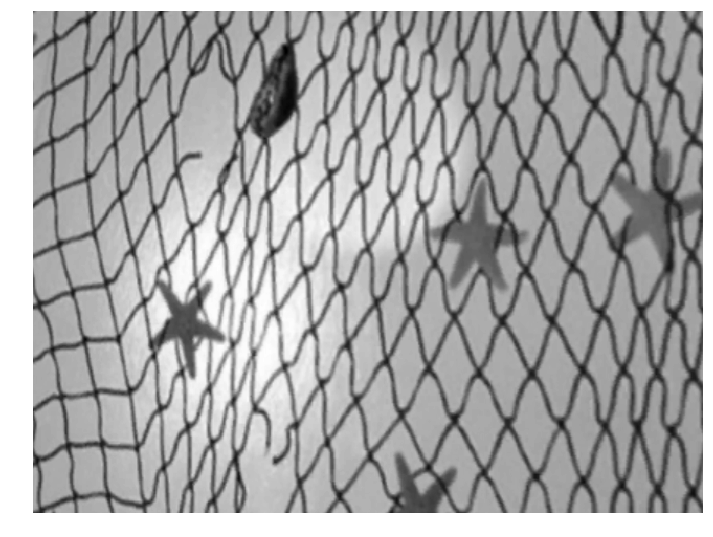

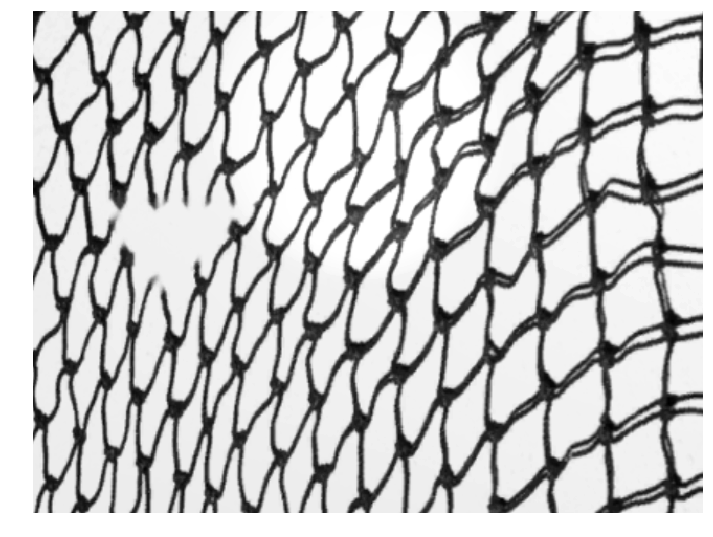

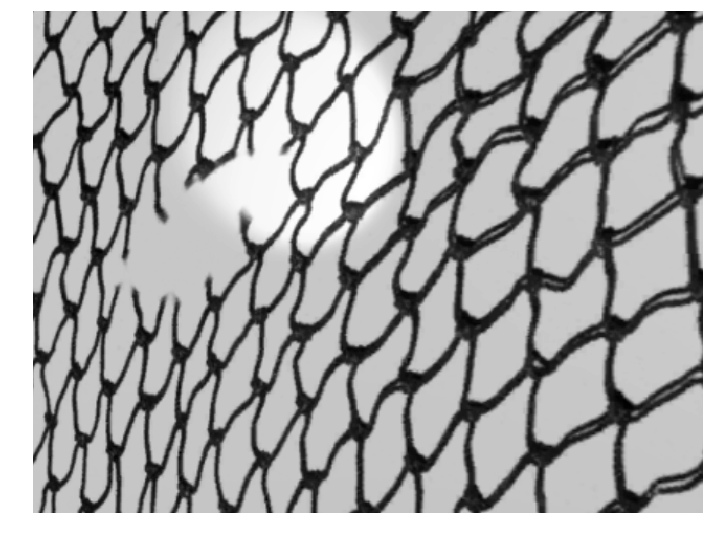

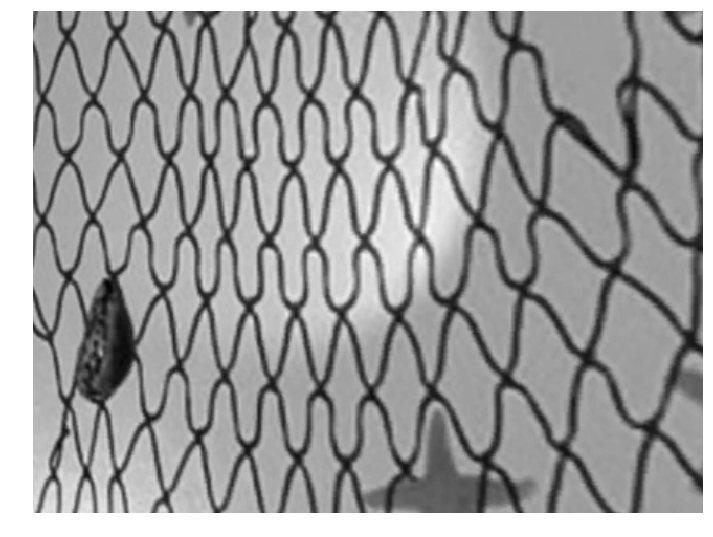

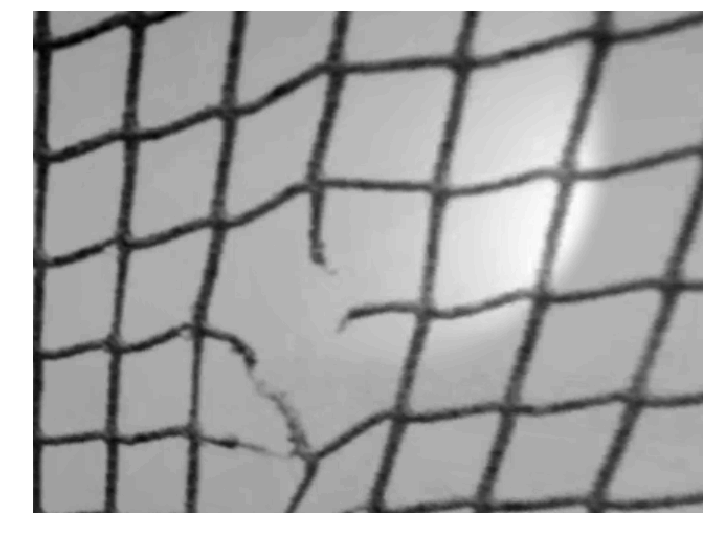

...

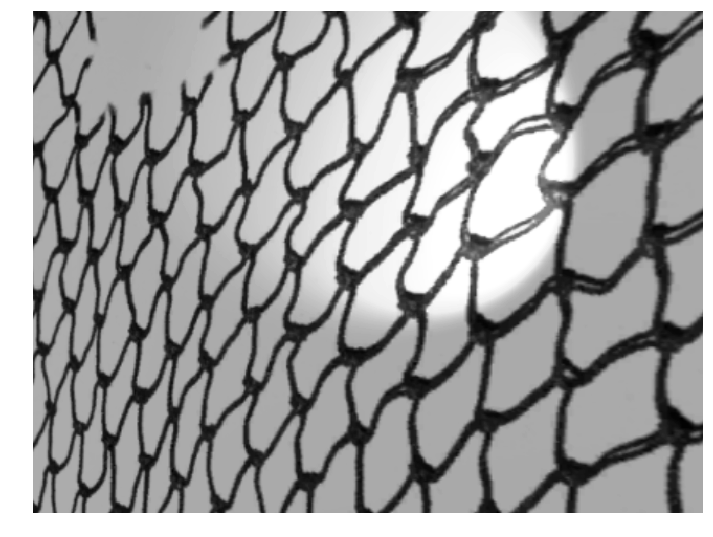

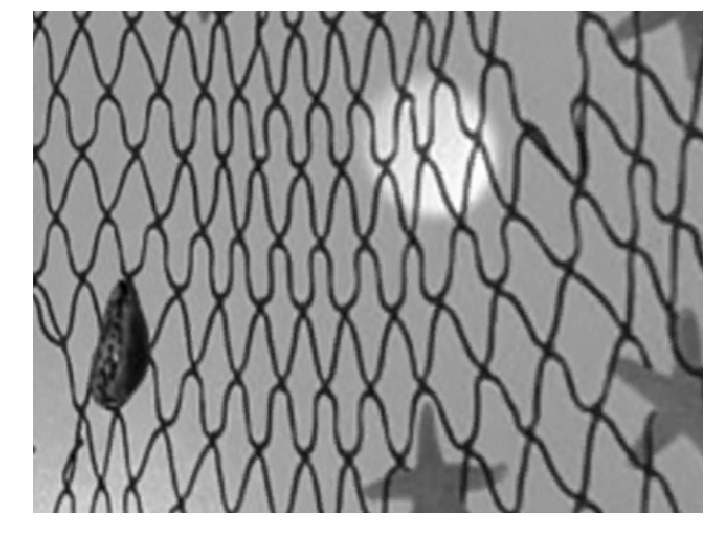

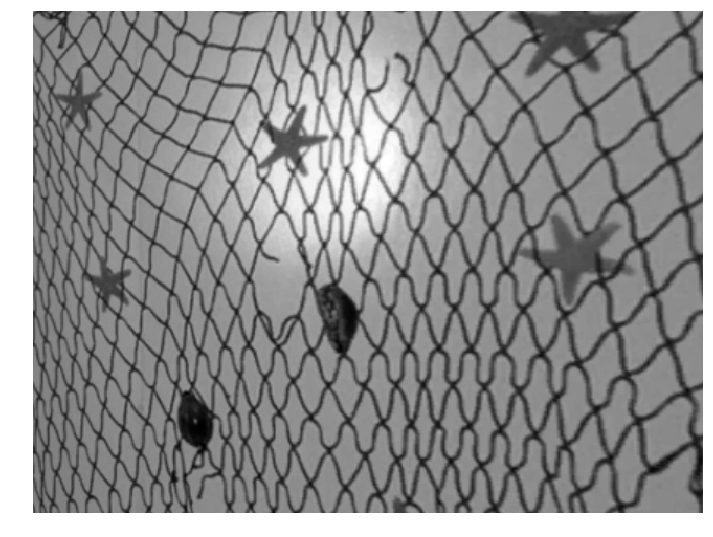

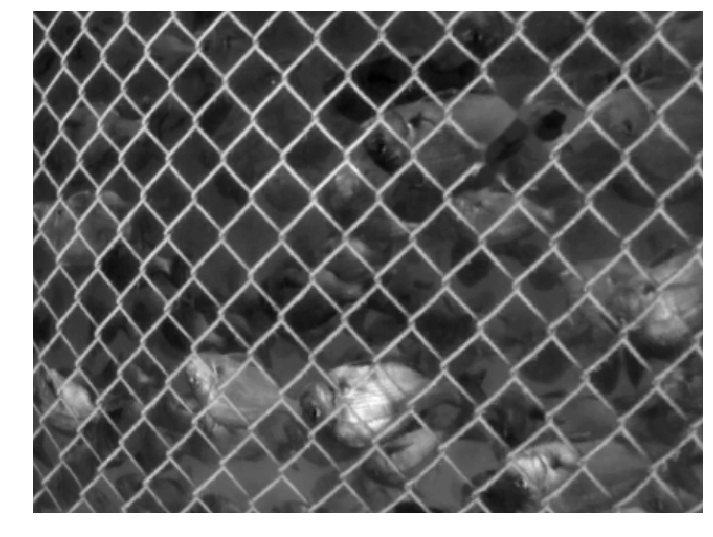

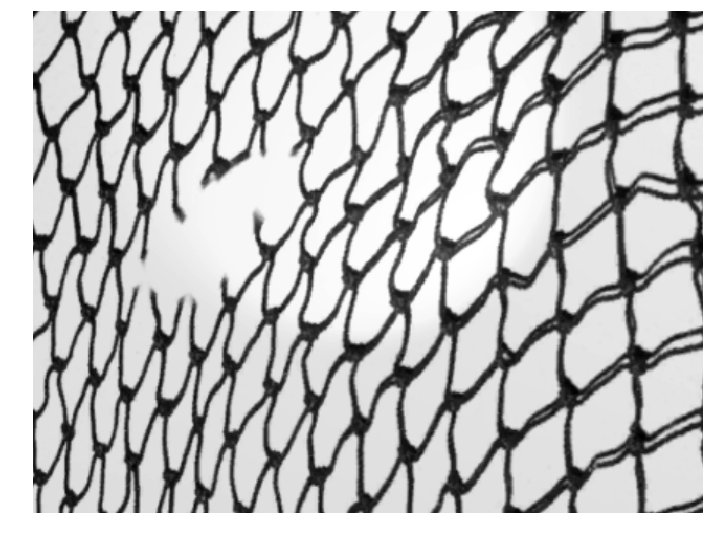

In [20]:
%matplotlib inline
import matplotlib.pyplot as plt

for i in range(len(fail_idx[0])):

    temp_img = ev_data_sh[fail_idx[0][i]][:].reshape([480, 640])


    width = 12
    height = 12
    plt.figure(figsize=(width, height))
    plt.axis("off")
    plt.imshow(temp_img, cmap="gray")
    plt.show()

In [22]:
image_dir = './data_oh/test-images/test-images_128/'
class_name = ['bite', 'cut', 'normal']

data_dir = {}

for i in range(len(class_name)):
    temp_dir = image_dir + class_name[i]
    
    if i == 2:
        label=0
    else:
        label=1
    img_files = [[os.path.join(temp_dir, f), np.int16(label)] for f in os.listdir(temp_dir) if f.endswith('.png')]
    data_dir[i] = img_files

new_dir = data_dir[0]
print(len(new_dir))
new_dir.extend(data_dir[1])
print(len(new_dir))
new_dir.extend(data_dir[2])
print(len(new_dir))

new_in = np.zeros((len(new_dir), total_pix), dtype=np.float32)
new_label = np.zeros((len(new_dir), 1), dtype=np.int32)
ev_new_results = np.zeros((len(new_dir), 1))

im_width = 640
im_height = 480

#untorn_data[i][:] = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).flatten()

for i in range(len(new_dir)):
    img = cv2.cvtColor(cv2.imread(new_dir[i][0]),cv2.COLOR_BGR2GRAY)
    new_in[i][:] = cv2.resize(img, (im_width, im_height), interpolation=cv2.INTER_CUBIC).flatten()
    new_label[i] = new_dir[i][1]
    
    
with tf.device('/device:GPU:3'):

    # Evaluate the model and print results
    for i in range(len(new_dir)):
        eval_input_fn = tf.estimator.inputs.numpy_input_fn(
            x={"x": new_in[i:i+1]},
            y=new_label[i:i+1],
            num_epochs=1,
            shuffle=False)
        eval_new_results = net_classifier.evaluate(input_fn=eval_input_fn)
        
        ev_new_results[i] = eval_new_results["accuracy"]

25
50
75
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:14:51
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:14:51
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 9.056214
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:14:51
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:14:51
INFO:tensorflow:Saving dict for global step 7

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:14:57
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 9.603588
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:14:58
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:14:58
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 6.7146554
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:14:58
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:15:04
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 2.981523
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:15:05
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:15:05
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 1.1597415
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tenso

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:15:11
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:15:11
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 1.4041946
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:15:11
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:15:12
INFO:tensorflow:Saving dict for global step 7344: acc

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:15:18
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.008568782
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:15:18
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:15:18
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 1.1221868
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:15:18
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/mod

In [23]:
print(np.mean(ev_new_results))
fail_idx2 = np.where(ev_new_results == 0)
print(fail_idx2[0])
print(len(fail_idx2[0]))

0.3333333333333333
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49
 63 67]
50


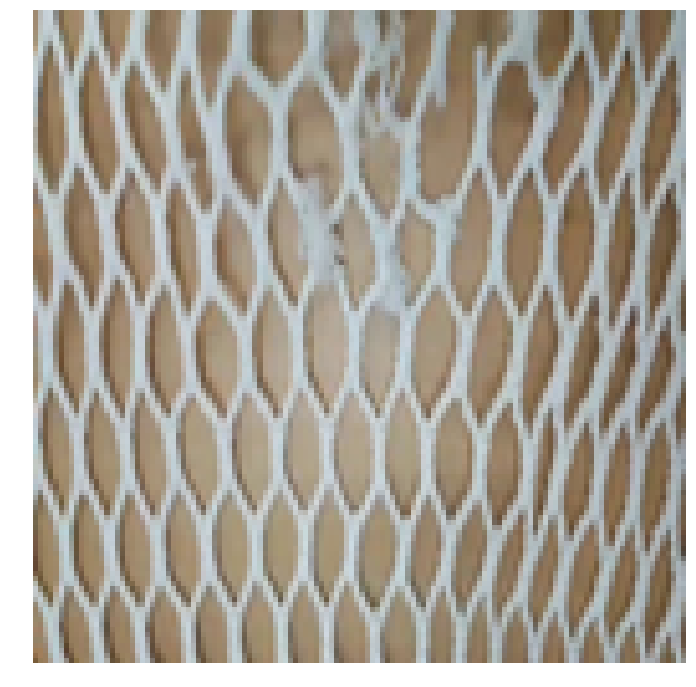

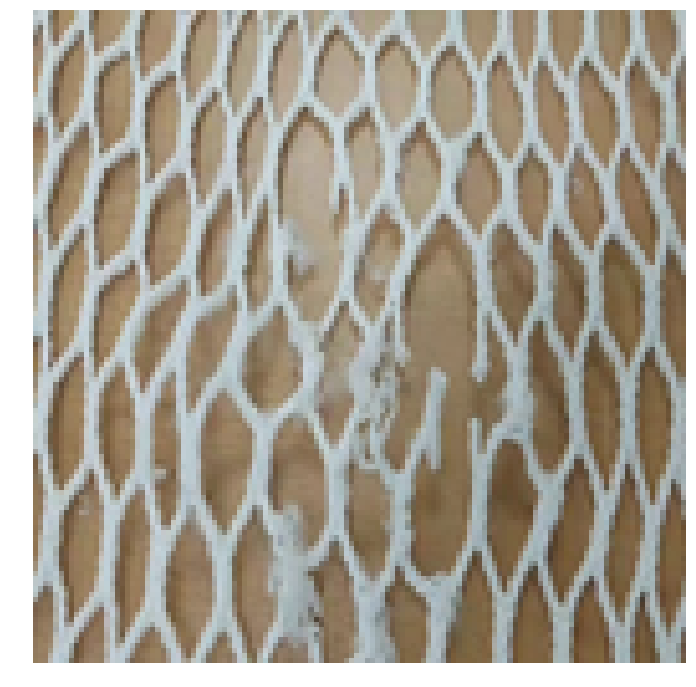

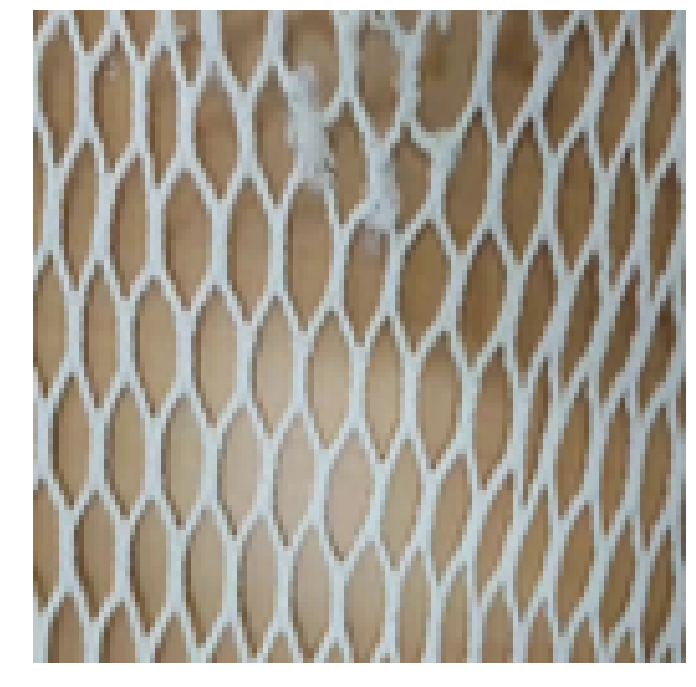

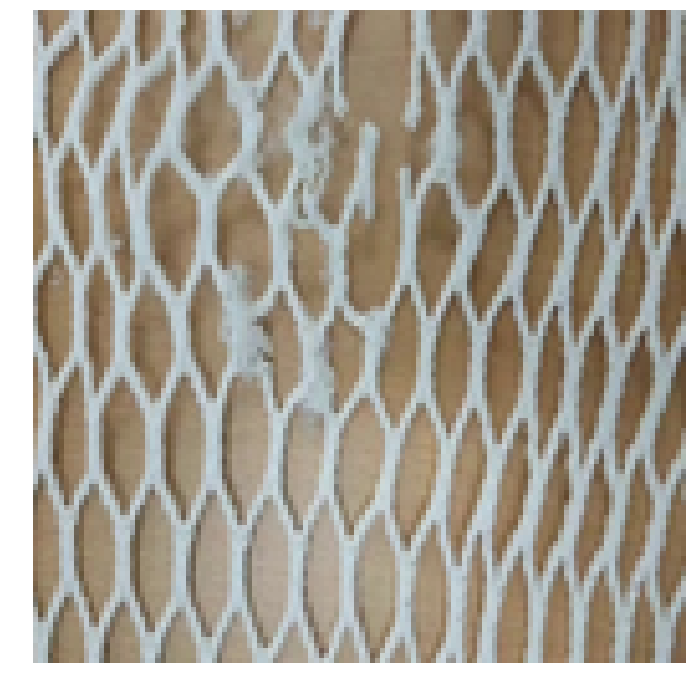

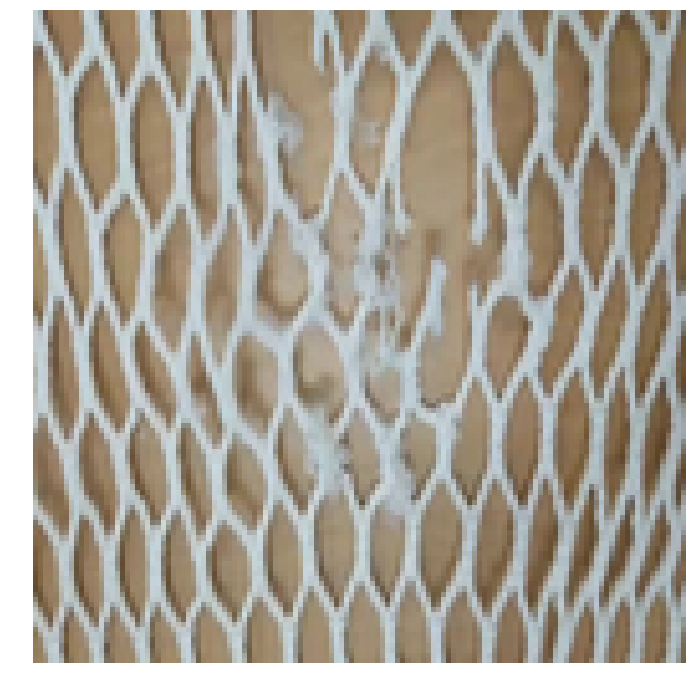

...

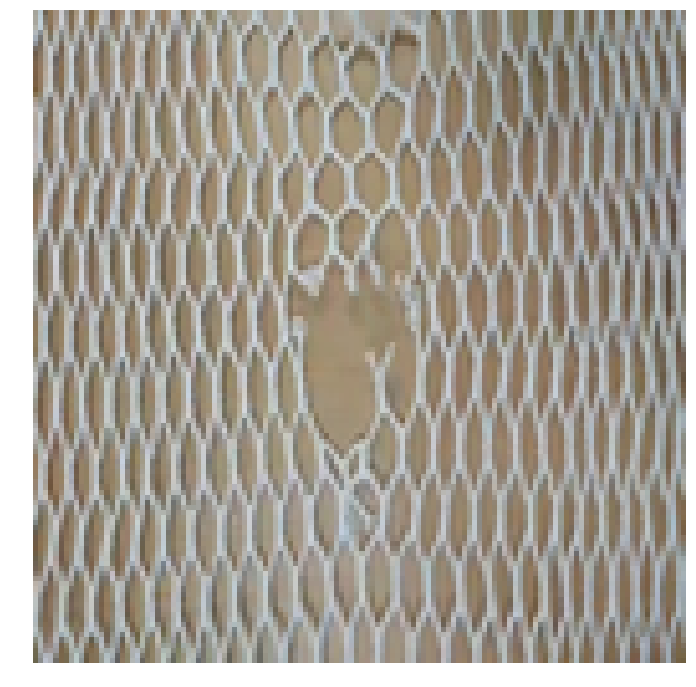

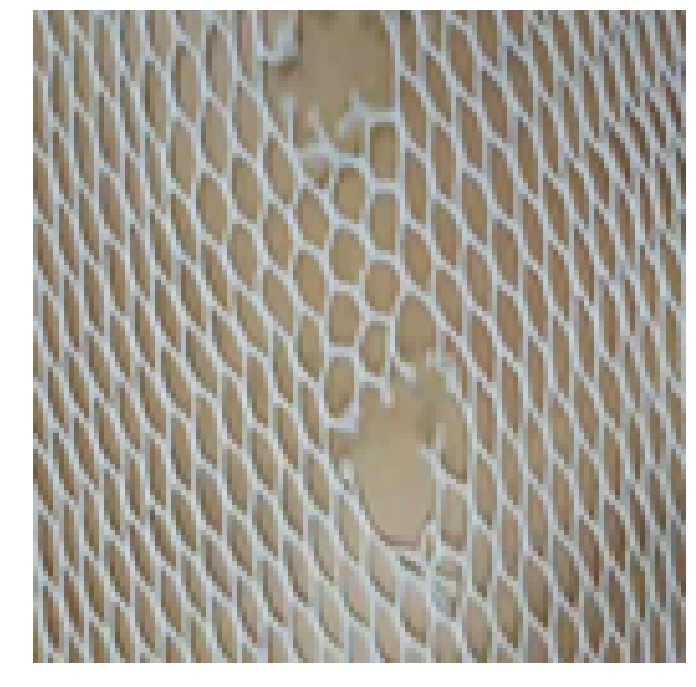

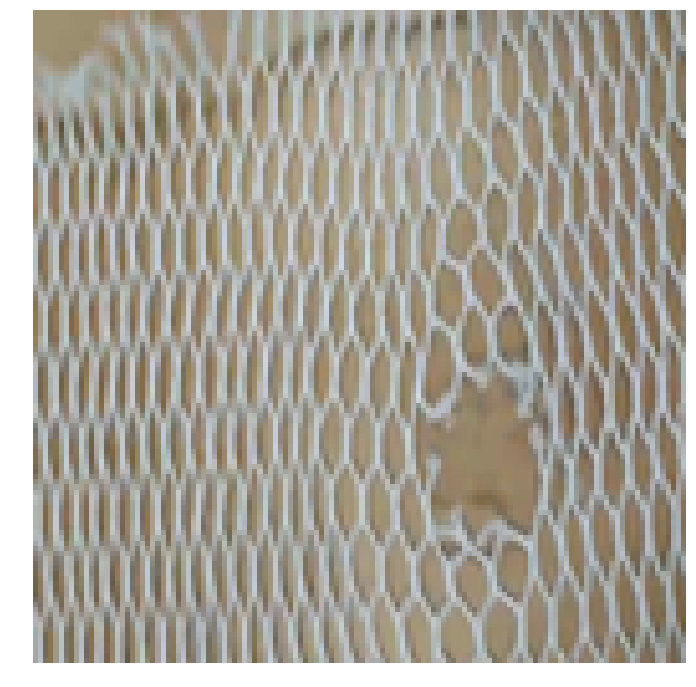

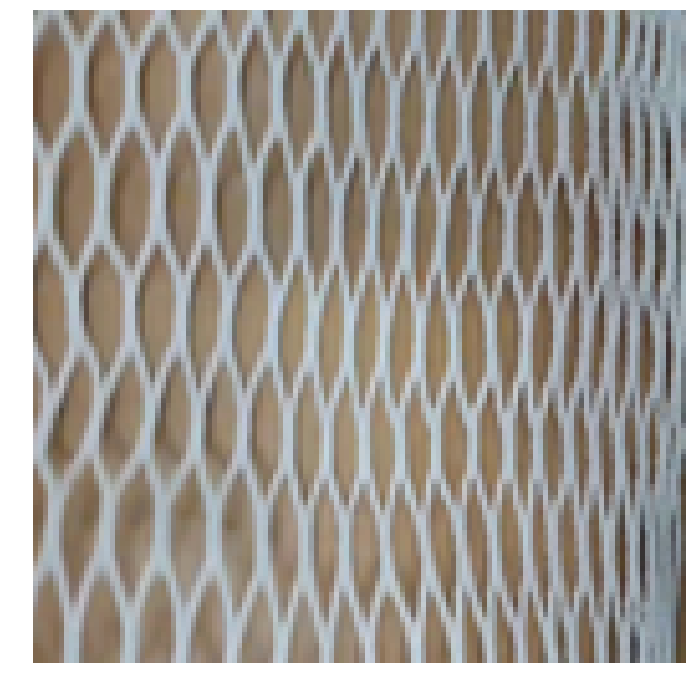

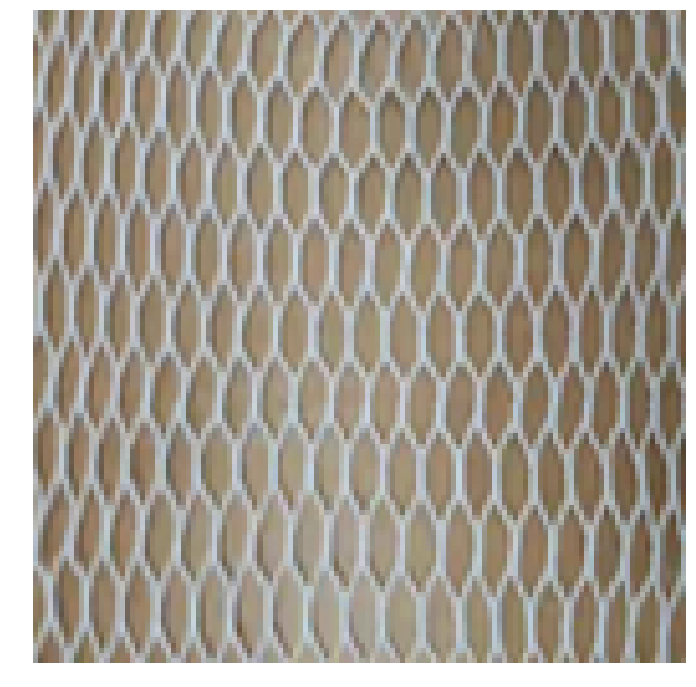

In [24]:
for i in range(len(fail_idx2[0])):
    temp_img = cv2.imread(new_dir[fail_idx2[0][i]][0])

    width = 12
    height = 12
    plt.figure(figsize=(width, height))
    plt.axis("off")
    plt.imshow(cv2.cvtColor(temp_img, cv2.COLOR_BGR2RGB))
    plt.show()

In [25]:
image_dir = './data_oh/train-images/train-images_128/'
class_name = ['bite', 'cut', 'normal']

data_dir = {}

for i in range(len(class_name)):
    temp_dir = image_dir + class_name[i]
    
    if i == 2:
        label=0
    else:
        label=1
    img_files = [[os.path.join(temp_dir, f), np.int16(label)] for f in os.listdir(temp_dir) if f.endswith('.png')]
    data_dir[i] = img_files

new_dir = data_dir[0]
print(len(new_dir))
new_dir.extend(data_dir[1])
print(len(new_dir))
new_dir.extend(data_dir[2])
print(len(new_dir))

new_in = np.zeros((len(new_dir), total_pix), dtype=np.float32)
new_label = np.zeros((len(new_dir), 1), dtype=np.int32)
ev_new_results = np.zeros((len(new_dir), 1))

im_width = 640
im_height = 480

#untorn_data[i][:] = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).flatten()

for i in range(len(new_dir)):
    img = cv2.cvtColor(cv2.imread(new_dir[i][0]),cv2.COLOR_BGR2GRAY)
    new_in[i][:] = cv2.resize(img, (im_width, im_height), interpolation=cv2.INTER_CUBIC).flatten()
    new_label[i] = new_dir[i][1]
    
    
with tf.device('/device:GPU:3'):

    # Evaluate the model and print results
    for i in range(len(new_dir)):
        eval_input_fn = tf.estimator.inputs.numpy_input_fn(
            x={"x": new_in[i:i+1]},
            y=new_label[i:i+1],
            num_epochs=1,
            shuffle=False)
        eval_new_results = net_classifier.evaluate(input_fn=eval_input_fn)
        
        ev_new_results[i] = eval_new_results["accuracy"]

85
170
255
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:18:50
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:18:50
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 6.01609
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:18:50
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:18:50
INFO:tensorflow:Saving dict for global step 

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:18:56
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 2.3328345
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:18:56
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:18:57
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 2.4085982
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:18:57
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:03
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 2.6592433
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:04
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:04
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 0.85264224
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:ten

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:10
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:10
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 1.987604
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:10
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:11
INFO:tensorflow:Saving dict for global step 7344: accu

INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:17
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 1.6481307
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:17
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:17
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 4.343406
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:17
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init

INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:24
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 4.409535
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:24
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:24
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 3.4287212
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:30
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:31
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 4.506741
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:31
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:31
INFO:tensorflow:Saving dict for global step 7344: accu

INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:37
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 4.0751514
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:37
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:37
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 2.4139166
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:38
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_ini

INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:44
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 4.07748
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:44
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:44
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 1.1929142
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-0

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:50
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:50
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 2.6855912
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:51
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:51
INFO:tensorflow:Saving dict for global step 7344: acc

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:57
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.5756208
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:57
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:19:57
INFO:tensorflow:Saving dict for global step 7344: accuracy = 0.0, global_step = 7344, loss = 4.3273816
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:19:57
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:03
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.14800152
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:20:04
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:04
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.0022706222
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:20:10
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:10
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.5394186
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:20:10
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:11
INFO:tensorflow:Saving dict for global step 7344: acc

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:16
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.6590242
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:20:17
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:17
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.45909655
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:20:17
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/mode

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:23
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.18233053
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:20:24
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:24
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.2015717
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:ten

INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:20:30
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:30
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.049861405
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:20:30
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:31
INFO:tensorflow:Saving dict for global step 7344: a

INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:37
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.039590843
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:20:37
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/model.ckpt-7344
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-02:20:37
INFO:tensorflow:Saving dict for global step 7344: accuracy = 1.0, global_step = 7344, loss = 0.090821885
INFO:tensorflow:Calling model_fn.
(?, 60, 80, 96)
(?, 28800)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-02:20:37
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600-0502_gray/m

In [26]:
print(np.mean(ev_new_results))

0.34509803921568627


In [27]:
fail_idx3 = np.where(ev_new_results == 0)
print(fail_idx3[0])
print(len(fail_idx3[0]))

[  0   1   2   3   5   6   7   8  10  11  12  13  15  16  18  20  21  22
  23  24  25  26  27  28  30  31  32  33  34  35  36  37  38  39  41  42
  44  45  46  47  48  49  50  51  53  54  55  56  57  58  59  60  61  62
  63  64  65  66  67  68  70  71  72  73  74  75  76  77  78  79  80  81
  82  83  84  85  86  87  88  89  90  92  93  94  95  96  98  99 100 101
 102 103 104 105 106 107 108 109 110 111 112 114 115 116 117 118 119 120
 121 122 123 125 126 127 128 129 130 131 132 135 136 137 138 139 141 142
 143 144 145 146 148 149 150 151 152 153 155 157 158 159 160 161 162 163
 164 165 166 167 169 177 185 191 193 194 196 197 205 207 212 213 215 216
 230 237 240 243 254]
167


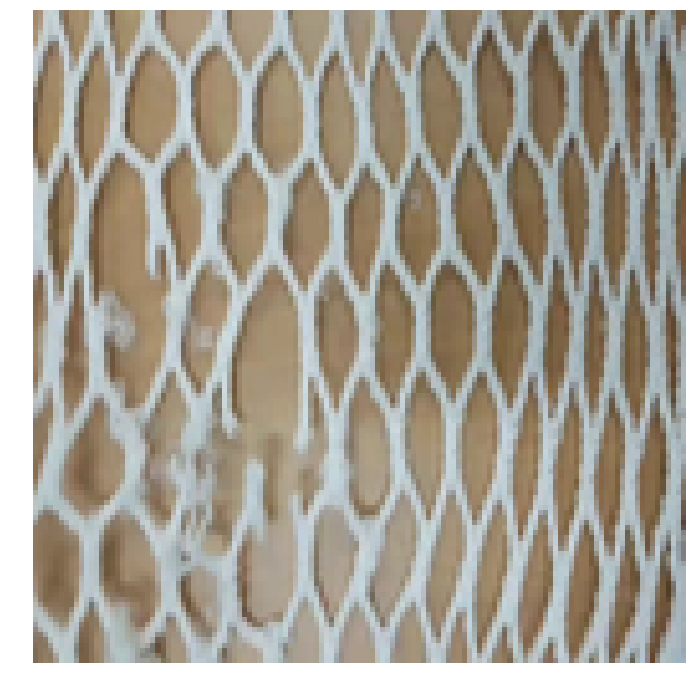

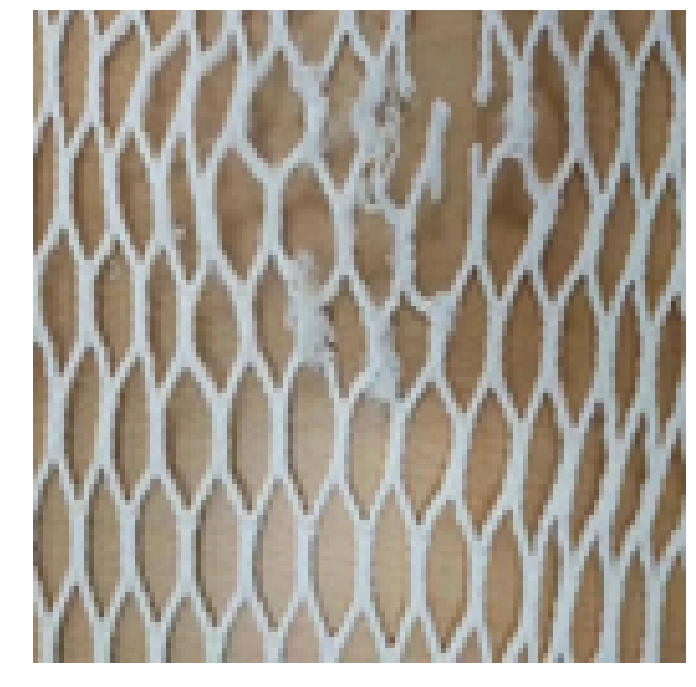

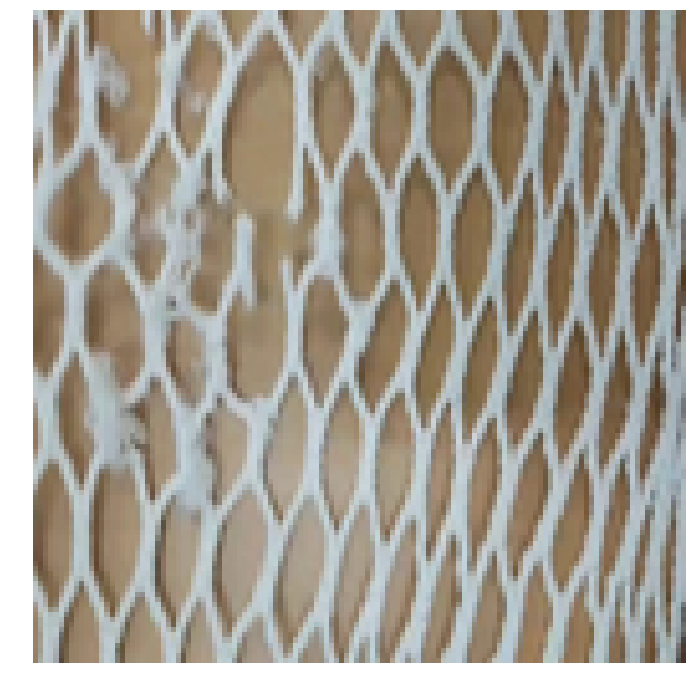

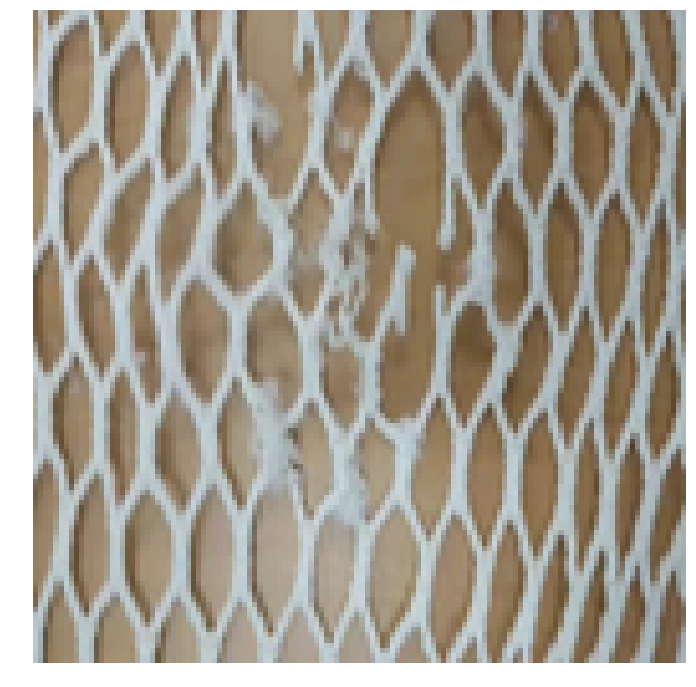

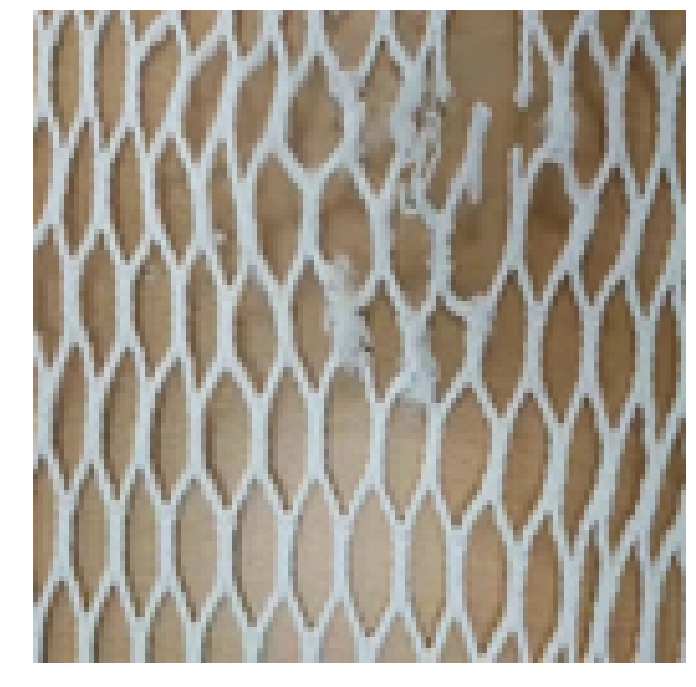

...

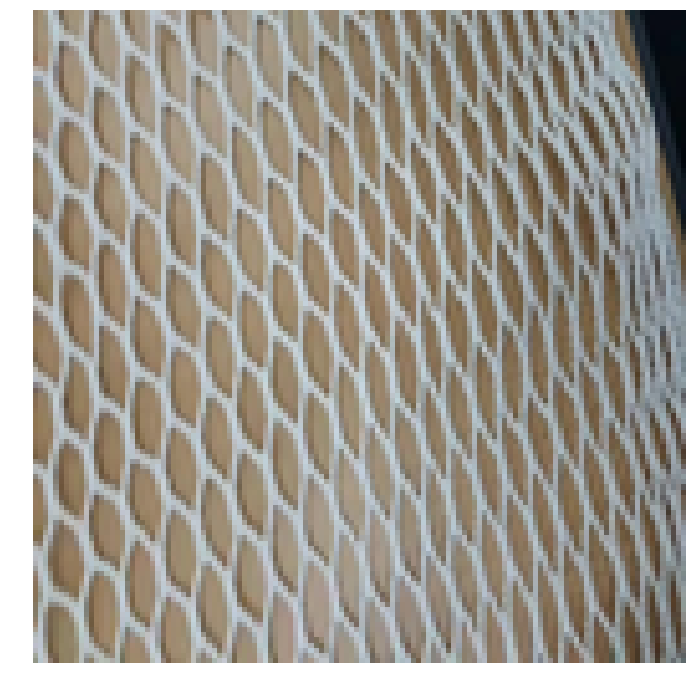

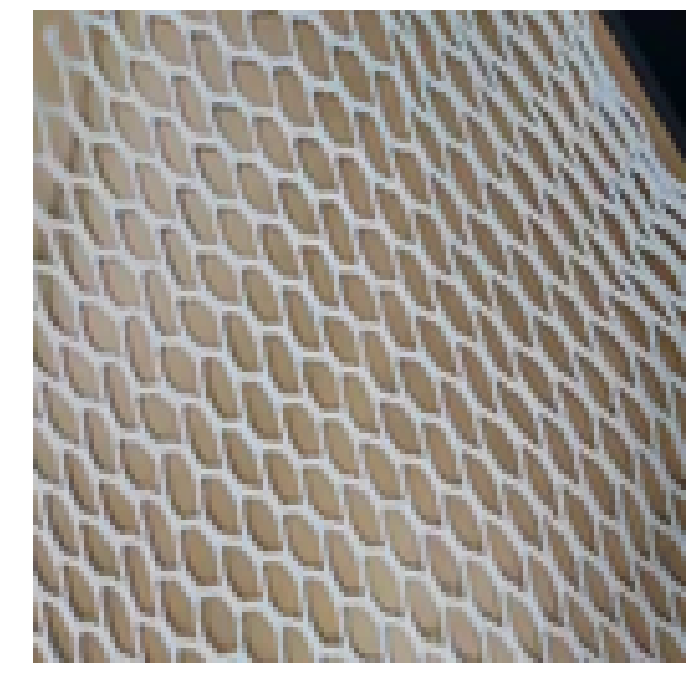

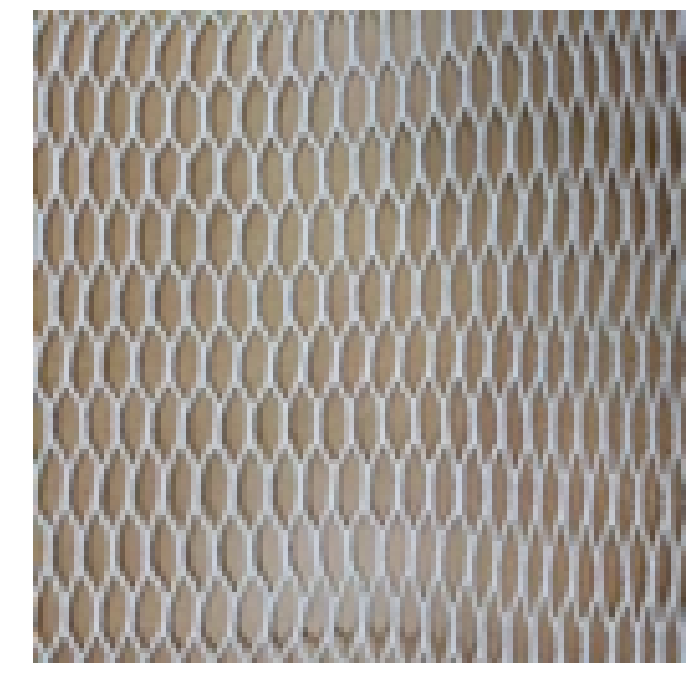

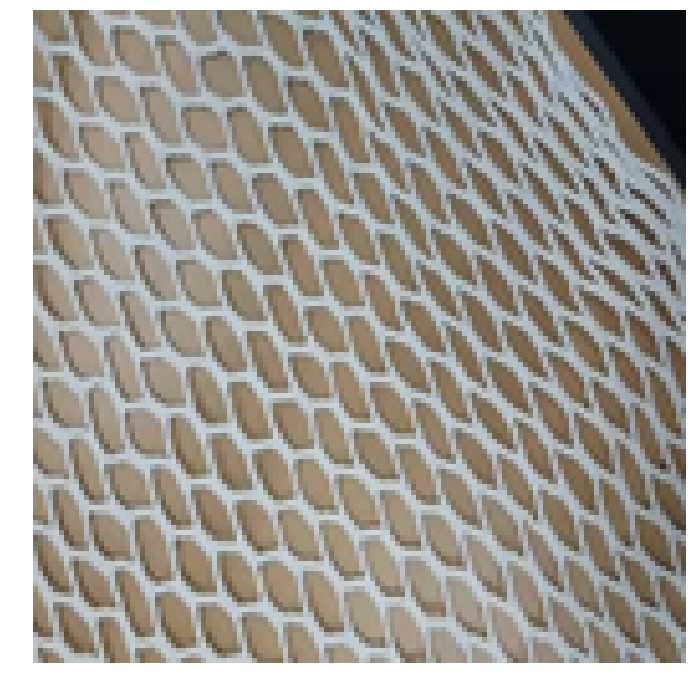

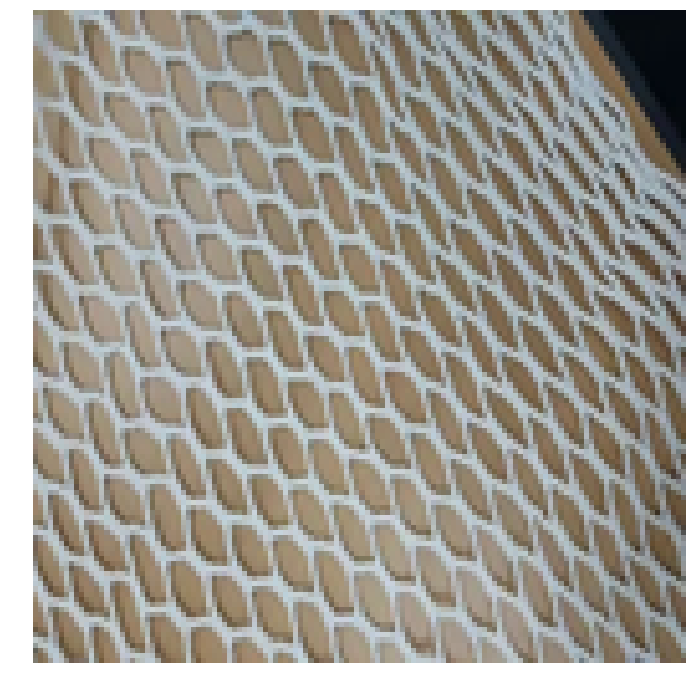

In [28]:
for i in range(len(fail_idx3[0])):
    temp_img = cv2.imread(new_dir[fail_idx3[0][i]][0])

    width = 12
    height = 12
    plt.figure(figsize=(width, height))
    plt.axis("off")
    plt.imshow(cv2.cvtColor(temp_img, cv2.COLOR_BGR2RGB))
    plt.show()